In [1]:
import numpy as np
import os
import mne
import pandas as pd
import hmp  
import matplotlib.pyplot as plt
from itertools import chain
from scipy.spatial.distance import squareform
import scipy.cluster.hierarchy as sch
from scipy.cluster.hierarchy import fcluster
import seaborn as sns
from sklearn.metrics import silhouette_score

In [2]:
def extract_timecourse_one_session(files, session_str, tmin, n_comp, location):
    """
    Extracts, preprocesses, and fits HMP models for a single session across multiple subjects.

    Parameters:
    - files (list of str): List of file names containing EEG data (e.g., .fif files).
    - session_str (str): String used to identify files corresponding to the session of interest.

    Returns:
    - models_dict (dict): Dictionary mapping subject IDs to their corresponding:
        - 'model': fitted HMP model object
        - 'epoch_data': preprocessed epoch-level data
        - 'init': initial (unfitted) model object

    Notes:
    - Filters annotations to include only events corresponding to start and end of trial
    - Applies HMP model fitting per subject.
    """
    models_dict = {}

    for file in files: 
        if session_str in file.split('_')[1][2:4]:
            print(f"Processing file: {file}")
            
            # 1. Read data
            raw = mne.io.read_raw_fif(os.path.join(epoch_data_path, file), preload=True)

           # 2. Extract annotations
            annotations = raw.annotations
            onset = annotations.onset
            description = annotations.description

            # 3. Create dataframe
            df = pd.DataFrame({"description": description, "onset": onset})

            # 4. Filter events
            df_filtered = df[df["description"].isin(["stim-all_stim", "trial_end"])].reset_index(drop=True)

            # 5. Map to event IDs
            mapping = {"stim-all_stim": 1, "trial_end": 2}
            df_filtered["event_id"] = df_filtered["description"].map(mapping)

            # 6. Convert to samples
            sfreq = int(raw.info['sfreq'])
            df_filtered["sample"] = (df_filtered["onset"] * sfreq).astype(int)

            # 7. Create previous column
            df_filtered["previous"] = 0

            # 8. Arrange columns
            df_events = df_filtered[["sample", "previous", "event_id"]]

            # 9. Convert to numpy
            events = df_events.values

            # 10. Define IDs
            event_id = {"stimulus": 1}
            resp_id = {"response": 2}

            # 11. Epoch data
            epoch_data = hmp.utils.read_mne_data(
                os.path.join(epoch_data_path, file),
                event_id=event_id,
                resp_id=resp_id,
                sfreq=500,
                events_provided=events,
                verbose=False,
                tmin=tmin,
                tmax=15
            )
            

            # 12. Transform data
            hmp_data = hmp.utils.transform_data(epoch_data, apply_standard=False, n_comp=n_comp)

            # 13. Initialize model
            model_init = hmp.models.hmp(
                data=hmp_data,
                sfreq=epoch_data.sfreq,
                cpus=4,
                event_width=50,
                distribution='gamma',
                shape=2,
                location=location
            )

            # 14. Fit model
            model = model_init.fit(verbose=False)

            # 15. Store in dictionary
            subject_id = "subject_" + file.split('_')[1][0:2]
            print(f"✅ Storing data for {subject_id}")

            models_dict[subject_id] = {
                "model": model,
                "epoch_data": epoch_data,
                "init": model_init
            }

    return models_dict

In [3]:
# -------------------------------
# Absolute timing (list) for one event
# -------------------------------

def event_abs_timing_list(eventprobs, event_n):
    """
    For a given event number, finds the time point in each trial where the event has the highest probability.

    Args:
        eventprobs: 3D array (trials × samples × events), probabilities for each event over time.
        event_n: Integer index of the event of interest.

    Returns:
        List of time indices (one per trial) where the given event is most probable (in sample indices).
    """
    trial_results = []

    for trial in range(len(eventprobs)):
        trial_probs = [eventprobs[trial][sample][event_n] for sample in range(len(eventprobs[trial]))]
        max_idx = trial_probs.index(max(trial_probs))
        trial_results.append(max_idx)

    return trial_results

# -------------------------------
# Absolute timing (DataFrame) for all events
# -------------------------------

def event_abs_timing_df(eventprobs, n_events):
    """
    Constructs a DataFrame showing, for each event, the sample index at which that event
    had the highest probability across trials.

    Args:
        eventprobs: 3D array (trials × samples × events), probabilities for each event over time.
        n_events: Integer, number of events.

    Returns:
        DataFrame of shape (trials × events), with each entry being the sample index of peak probability.
    """
    abs_timing_dict = {}

    for event in range(n_events):
        abs_timing_list = event_abs_timing_list(eventprobs, event)
        abs_timing_dict[event] = abs_timing_list

    return pd.DataFrame(abs_timing_dict)

# -------------------------------
# Relative timing (list) for one event
# -------------------------------

def event_rel_timing_list(eventprobs, rt, event_n):
    """
    Calculate the relative timing of a specific event within each trial,
    expressed as a proportion of the reaction time.

    Args:
        eventprobs: 3D array (trials × samples × events), probabilities for each event over time.
        rt: List of reaction times (in seconds), one per trial.
        event_n: Integer index of the event of interest.

    Returns:
        List of relative timings (one per trial).
    """
    trial_results = []

    for trial in range(len(eventprobs)):
        trial_probs = [eventprobs[trial][sample][event_n] for sample in range(len(eventprobs[trial]))]
        max_idx = trial_probs.index(max(trial_probs))

        # Convert sample index to milliseconds (500 Hz = 2 ms per sample)
        event_ms = max_idx * 2
        rt_ms = rt[trial] * 1000

        trial_results.append(event_ms / rt_ms)

    return trial_results

# -------------------------------
# Relative timing (DataFrame) for all events
# -------------------------------

def event_rel_timing_df(eventprobs, rt, n_events):
    """
    Constructs a DataFrame showing, for each event, the relative timing (as a proportion of total trial duration)
    at which that event had the highest probability across trials.

    Args:
        eventprobs: 3D array (trials × samples × events), probabilities for each event over time.
        rt: List or array of reaction times (in seconds), one per trial.
        n_events: Integer, number of events.

    Returns:
        DataFrame with shape (trials x events), with each value being the relative timing of peak probability.
    """
    rel_timing_dict = {}

    for event in range(n_events):
        rel_timing_list = event_rel_timing_list(eventprobs, rt, event)
        rel_timing_dict[event] = rel_timing_list

    return pd.DataFrame(rel_timing_dict)

In [4]:
# -------------------------------
# Average EEG topomap for a single event
# -------------------------------

def average_map_for_event(event_timing_list, epoch_data):
    """
    Computes the average topographic map at given event timepoints across all trials.

    Args:
        event_timing_list: List of sample indices per trial for the event.
        epoch_data: Xarray with dimensions (participants x epochs × channels × samples).
    
    Returns:
        1D numpy array representing the average topographic map (mean over trials).
    """
    all_maps = []
    for idx, sample_idx in enumerate(event_timing_list):
        # index [0] removes the participant dimension (only one participant processed at a time)
        values = epoch_data.isel(epochs=idx, samples=sample_idx).data.values[0]
        all_maps.append(values)
    
    all_maps_array = np.array(all_maps)
    avg_map = np.mean(all_maps_array, axis=0)
    return avg_map

# -------------------------------
# Mean spatial correlation across trials for each event (absolute or signed)
# -------------------------------

def corr_maps_per_event(event_abs_timing_df, epoch_data, absolute=False):
    """
    Calculates the mean spatial correlation of EEG topographies across trials for each event.

    Args:
        event_abs_timing_df: DataFrame with sample indices per trial (from event_abs_timing_df) for each event. 
        epoch_data: Xarray with dimensions (participants × epochs × channels × samples).
        absolute: Bool, if True computes absolute correlations (ignores polarity).
                  If False computes signed correlations.

    Returns:
        List of mean pairwise correlations between topographies for each event.
    """
    event_corr_list = []

    for event in event_abs_timing_df.columns:
        matrix_of_values = []
        list_timing = event_abs_timing_df[event]

        for idx, sample_idx in enumerate(list_timing):
            # index [0] removes the participant dimension (only one participant processed at a time)
            values = epoch_data.isel(epochs=idx, samples=sample_idx).data.values[0]
            matrix_of_values.append(values)

        matrix_df = pd.DataFrame(matrix_of_values)
        similarity_matrix = matrix_df.T.corr()

        if absolute:
            similarity_matrix = similarity_matrix.abs()

        upper_triangle = similarity_matrix.where(np.triu(np.ones(similarity_matrix.shape), k=1).astype(bool))
        mean_corr = upper_triangle.stack().mean()
        event_corr_list.append(mean_corr)

    return event_corr_list

# -------------------------------
# Subject-wise event correlations
# -------------------------------

def compute_subjectwise_event_correlations(models_dict):
    """
    Runs the spatial correlation analysis pipeline for each subject.

    Returns:
    - Dictionary mapping each subject to a list of mean event correlations.
    """
    maps_corr_dict = {}

    for subject in models_dict:
        print(f"Starting subject: {subject}", flush=True)

        model = models_dict[subject]["model"]
        epoch_data = models_dict[subject]["epoch_data"]

        eventprobs = model.eventprobs.values
        n_events = eventprobs.shape[2]

        # Get sample indices of peak event probabilities
        event_abs_timing_df_ = event_abs_timing_df(eventprobs, n_events)

        # Compute mean spatial correlation per event
        event_corr_list = corr_maps_per_event(event_abs_timing_df_, epoch_data)

        maps_corr_dict[subject] = event_corr_list
        print(f"✅ Finished {subject}", flush=True)

    return maps_corr_dict

In [5]:
# -------------------------------
# Plot time course per subject
# -------------------------------

def plot_timecourses(model_dict, correlation_dict, positions):
    """
    Plots topographic time courses for each subject, sorted by mean spatial correlation.

    Parameters:
    - model_dict (dict): Contains 'model', 'epoch_data', and 'init' for each subject.
    - correlation_dict (dict): Mean spatial correlation values per subject.
    - positions: Sensor/electrode positions for topographic plotting.
    """
    # Sort the subjects by their mean correlation values

    # Plot time course for each subject
    for subject in correlation_dict:
        model_info = model_dict[subject]
        model = model_info["model"]
        epoch_data = model_info["epoch_data"]
        init = model_info["init"]
        mean_corr = correlation_dict[subject]

        # Create and show figure
        plt.figure(figsize=(10, 4))
        hmp.visu.plot_topo_timecourse(epoch_data, model,
                                      positions, init,
                                      magnify=1, sensors=False,
                                      as_time=True)
        plt.suptitle(f"{subject} – Event Corr: {mean_corr:.3f}")
        plt.show()

### HMP Fittings 

Models first session

In [6]:
# Load data and path
epoch_data_path = os.path.join(os.getcwd())
files = [x for x in os.listdir(epoch_data_path) if "preprocessed-raw.fif" in x]

In [7]:
models_first_session = extract_timecourse_one_session(files, "01", -0.2, 10, 50)

Processing file: subj_0101_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0101_preprocessed-raw.fif...
    Range : 0 ... 3393535 =      0.000 ...  1657.000 secs
Ready.
Reading 0 ... 3393535  =      0.000 ...  1657.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0101_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0101_preprocessed-raw.fif


  0%|          | 0/3216 [00:00<?, ?it/s]

✅ Storing data for subject_01
Processing file: subj_0201_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0201_preprocessed-raw.fif...
    Range : 0 ... 3141631 =      0.000 ...  1534.000 secs
Ready.
Reading 0 ... 3141631  =      0.000 ...  1534.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0201_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
83 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0201_preprocessed-raw.fif


  0%|          | 0/1516 [00:00<?, ?it/s]

✅ Storing data for subject_02
Processing file: subj_0301_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0301_preprocessed-raw.fif...
    Range : 0 ... 3440639 =      0.000 ...  1680.000 secs
Ready.
Reading 0 ... 3440639  =      0.000 ...  1680.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0301_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
83 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0301_preprocessed-raw.fif


  0%|          | 0/1778 [00:00<?, ?it/s]

✅ Storing data for subject_03
Processing file: subj_0401_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0401_preprocessed-raw.fif...
    Range : 0 ... 3743743 =      0.000 ...  1828.000 secs
Ready.
Reading 0 ... 3743743  =      0.000 ...  1828.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0401_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
83 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0401_preprocessed-raw.fif


  0%|          | 0/1763 [00:00<?, ?it/s]

✅ Storing data for subject_04
Processing file: subj_0501_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0501_preprocessed-raw.fif...
    Range : 0 ... 3577855 =      0.000 ...  1747.000 secs
Ready.
Reading 0 ... 3577855  =      0.000 ...  1747.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0501_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0501_preprocessed-raw.fif


  0%|          | 0/2431 [00:00<?, ?it/s]

✅ Storing data for subject_05
Processing file: subj_0601_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0601_preprocessed-raw.fif...
    Range : 0 ... 3647487 =      0.000 ...  1781.000 secs
Ready.
Reading 0 ... 3647487  =      0.000 ...  1781.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0601_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
82 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0601_preprocessed-raw.fif


  0%|          | 0/2705 [00:00<?, ?it/s]

✅ Storing data for subject_06
Processing file: subj_0801_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0801_preprocessed-raw.fif...
    Range : 0 ... 3819519 =      0.000 ...  1865.000 secs
Ready.
Reading 0 ... 3819519  =      0.000 ...  1865.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0801_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
82 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0801_preprocessed-raw.fif


  0%|          | 0/1623 [00:00<?, ?it/s]

✅ Storing data for subject_08
Processing file: subj_0901_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0901_preprocessed-raw.fif...
    Range : 0 ... 2650111 =      0.000 ...  1294.000 secs
Ready.
Reading 0 ... 2650111  =      0.000 ...  1294.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0901_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
82 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0901_preprocessed-raw.fif


  0%|          | 0/1135 [00:00<?, ?it/s]

✅ Storing data for subject_09
Processing file: subj_1001_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1001_preprocessed-raw.fif...
    Range : 0 ... 3461119 =      0.000 ...  1690.000 secs
Ready.
Reading 0 ... 3461119  =      0.000 ...  1690.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1001_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
83 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1001_preprocessed-raw.fif


  0%|          | 0/1369 [00:00<?, ?it/s]

✅ Storing data for subject_10
Processing file: subj_1101_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1101_preprocessed-raw.fif...
    Range : 0 ... 3170303 =      0.000 ...  1548.000 secs
Ready.
Reading 0 ... 3170303  =      0.000 ...  1548.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1101_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
83 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1101_preprocessed-raw.fif


  0%|          | 0/2145 [00:00<?, ?it/s]

✅ Storing data for subject_11
Processing file: subj_1201_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1201_preprocessed-raw.fif...
    Range : 0 ... 2865151 =      0.000 ...  1399.000 secs
Ready.
Reading 0 ... 2865151  =      0.000 ...  1399.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1201_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
81 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1201_preprocessed-raw.fif


  0%|          | 0/1789 [00:00<?, ?it/s]

✅ Storing data for subject_12
Processing file: subj_1401_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1401_preprocessed-raw.fif...
    Range : 0 ... 3289087 =      0.000 ...  1606.000 secs
Ready.
Reading 0 ... 3289087  =      0.000 ...  1606.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1401_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
76 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1401_preprocessed-raw.fif


  0%|          | 0/2375 [00:00<?, ?it/s]

✅ Storing data for subject_14
Processing file: subj_1501_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1501_preprocessed-raw.fif...
    Range : 0 ... 2830335 =      0.000 ...  1382.000 secs
Ready.
Reading 0 ... 2830335  =      0.000 ...  1382.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1501_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
82 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1501_preprocessed-raw.fif


  0%|          | 0/2098 [00:00<?, ?it/s]

✅ Storing data for subject_15
Processing file: subj_1601_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1601_preprocessed-raw.fif...
    Range : 0 ... 3616767 =      0.000 ...  1766.000 secs
Ready.
Reading 0 ... 3616767  =      0.000 ...  1766.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1601_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
82 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1601_preprocessed-raw.fif


  0%|          | 0/2329 [00:00<?, ?it/s]

✅ Storing data for subject_16
Processing file: subj_1701_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1701_preprocessed-raw.fif...
    Range : 0 ... 3248127 =      0.000 ...  1586.000 secs
Ready.
Reading 0 ... 3248127  =      0.000 ...  1586.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1701_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
82 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1701_preprocessed-raw.fif


  0%|          | 0/2844 [00:00<?, ?it/s]

✅ Storing data for subject_17
Processing file: subj_1801_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1801_preprocessed-raw.fif...
    Range : 0 ... 2553855 =      0.000 ...  1247.000 secs
Ready.
Reading 0 ... 2553855  =      0.000 ...  1247.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1801_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
82 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1801_preprocessed-raw.fif


  0%|          | 0/1534 [00:00<?, ?it/s]

✅ Storing data for subject_18
Processing file: subj_1901_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1901_preprocessed-raw.fif...
    Range : 0 ... 3016703 =      0.000 ...  1473.000 secs
Ready.
Reading 0 ... 3016703  =      0.000 ...  1473.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1901_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1901_preprocessed-raw.fif


  0%|          | 0/2248 [00:00<?, ?it/s]

✅ Storing data for subject_19
Processing file: subj_2001_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2001_preprocessed-raw.fif...
    Range : 0 ... 3440639 =      0.000 ...  1680.000 secs
Ready.
Reading 0 ... 3440639  =      0.000 ...  1680.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2001_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
83 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2001_preprocessed-raw.fif


  0%|          | 0/2022 [00:00<?, ?it/s]

✅ Storing data for subject_20
Processing file: subj_2201_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2201_preprocessed-raw.fif...
    Range : 0 ... 2750463 =      0.000 ...  1343.000 secs
Ready.
Reading 0 ... 2750463  =      0.000 ...  1343.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2201_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
82 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2201_preprocessed-raw.fif


  0%|          | 0/2345 [00:00<?, ?it/s]

✅ Storing data for subject_22
Processing file: subj_2501_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2501_preprocessed-raw.fif...
    Range : 0 ... 2500607 =      0.000 ...  1221.000 secs
Ready.
Reading 0 ... 2500607  =      0.000 ...  1221.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2501_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
82 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2501_preprocessed-raw.fif


  0%|          | 0/1118 [00:00<?, ?it/s]

✅ Storing data for subject_25


Models second session

In [8]:
models_second_session = extract_timecourse_one_session(files, "02", -0.2, 10, 50)

Processing file: subj_0102_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0102_preprocessed-raw.fif...
    Range : 0 ... 3616767 =      0.000 ...  1766.000 secs
Ready.
Reading 0 ... 3616767  =      0.000 ...  1766.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0102_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0102_preprocessed-raw.fif


  0%|          | 0/2216 [00:00<?, ?it/s]

✅ Storing data for subject_01
Processing file: subj_0202_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0202_preprocessed-raw.fif...
    Range : 0 ... 2953215 =      0.000 ...  1442.000 secs
Ready.
Reading 0 ... 2953215  =      0.000 ...  1442.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0202_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0202_preprocessed-raw.fif


  0%|          | 0/926 [00:00<?, ?it/s]

✅ Storing data for subject_02
Processing file: subj_0302_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0302_preprocessed-raw.fif...
    Range : 0 ... 3180543 =      0.000 ...  1553.000 secs
Ready.
Reading 0 ... 3180543  =      0.000 ...  1553.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0302_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0302_preprocessed-raw.fif


  0%|          | 0/2156 [00:00<?, ?it/s]

✅ Storing data for subject_03
Processing file: subj_0402_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0402_preprocessed-raw.fif...
    Range : 0 ... 3629055 =      0.000 ...  1772.000 secs
Ready.
Reading 0 ... 3629055  =      0.000 ...  1772.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0402_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0402_preprocessed-raw.fif


  0%|          | 0/1181 [00:00<?, ?it/s]

✅ Storing data for subject_04
Processing file: subj_0502_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0502_preprocessed-raw.fif...
    Range : 0 ... 3004415 =      0.000 ...  1467.000 secs
Ready.
Reading 0 ... 3004415  =      0.000 ...  1467.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0502_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
76 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0502_preprocessed-raw.fif


  0%|          | 0/2239 [00:00<?, ?it/s]

✅ Storing data for subject_05
Processing file: subj_0602_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0602_preprocessed-raw.fif...
    Range : 0 ... 3436543 =      0.000 ...  1678.000 secs
Ready.
Reading 0 ... 3436543  =      0.000 ...  1678.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0602_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0602_preprocessed-raw.fif


  0%|          | 0/2304 [00:00<?, ?it/s]

✅ Storing data for subject_06
Processing file: subj_0802_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0802_preprocessed-raw.fif...
    Range : 0 ... 3786751 =      0.000 ...  1849.000 secs
Ready.
Reading 0 ... 3786751  =      0.000 ...  1849.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0802_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0802_preprocessed-raw.fif


  0%|          | 0/1002 [00:00<?, ?it/s]

✅ Storing data for subject_08
Processing file: subj_0902_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0902_preprocessed-raw.fif...
    Range : 0 ... 2369535 =      0.000 ...  1157.000 secs
Ready.
Reading 0 ... 2369535  =      0.000 ...  1157.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0902_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0902_preprocessed-raw.fif


  0%|          | 0/639 [00:00<?, ?it/s]

✅ Storing data for subject_09
Processing file: subj_1002_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1002_preprocessed-raw.fif...
    Range : 0 ... 2193407 =      0.000 ...  1071.000 secs
Ready.
Reading 0 ... 2193407  =      0.000 ...  1071.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1002_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1002_preprocessed-raw.fif


  0%|          | 0/1020 [00:00<?, ?it/s]

✅ Storing data for subject_10
Processing file: subj_1102_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1102_preprocessed-raw.fif...
    Range : 0 ... 2693119 =      0.000 ...  1315.000 secs
Ready.
Reading 0 ... 2693119  =      0.000 ...  1315.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1102_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1102_preprocessed-raw.fif


  0%|          | 0/1457 [00:00<?, ?it/s]

✅ Storing data for subject_11
Processing file: subj_1202_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1202_preprocessed-raw.fif...
    Range : 0 ... 2521087 =      0.000 ...  1231.000 secs
Ready.
Reading 0 ... 2521087  =      0.000 ...  1231.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1202_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1202_preprocessed-raw.fif


  0%|          | 0/1701 [00:00<?, ?it/s]

✅ Storing data for subject_12
Processing file: subj_1402_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1402_preprocessed-raw.fif...
    Range : 0 ... 2822143 =      0.000 ...  1378.000 secs
Ready.
Reading 0 ... 2822143  =      0.000 ...  1378.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1402_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1402_preprocessed-raw.fif


  0%|          | 0/1818 [00:00<?, ?it/s]

✅ Storing data for subject_14
Processing file: subj_1502_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1502_preprocessed-raw.fif...
    Range : 0 ... 2445311 =      0.000 ...  1194.000 secs
Ready.
Reading 0 ... 2445311  =      0.000 ...  1194.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1502_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1502_preprocessed-raw.fif


  0%|          | 0/1613 [00:00<?, ?it/s]

✅ Storing data for subject_15
Processing file: subj_1602_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1602_preprocessed-raw.fif...
    Range : 0 ... 3414015 =      0.000 ...  1667.000 secs
Ready.
Reading 0 ... 3414015  =      0.000 ...  1667.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1602_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1602_preprocessed-raw.fif


  0%|          | 0/1465 [00:00<?, ?it/s]

✅ Storing data for subject_16
Processing file: subj_1702_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1702_preprocessed-raw.fif...
    Range : 0 ... 2422783 =      0.000 ...  1183.000 secs
Ready.
Reading 0 ... 2422783  =      0.000 ...  1183.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1702_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1702_preprocessed-raw.fif


  0%|          | 0/1691 [00:00<?, ?it/s]

✅ Storing data for subject_17
Processing file: subj_1802_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1802_preprocessed-raw.fif...
    Range : 0 ... 2181119 =      0.000 ...  1065.000 secs
Ready.
Reading 0 ... 2181119  =      0.000 ...  1065.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1802_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1802_preprocessed-raw.fif


  0%|          | 0/833 [00:00<?, ?it/s]

✅ Storing data for subject_18
Processing file: subj_1902_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1902_preprocessed-raw.fif...
    Range : 0 ... 2754559 =      0.000 ...  1345.000 secs
Ready.
Reading 0 ... 2754559  =      0.000 ...  1345.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1902_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
78 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1902_preprocessed-raw.fif


  0%|          | 0/2838 [00:00<?, ?it/s]

✅ Storing data for subject_19
Processing file: subj_2002_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2002_preprocessed-raw.fif...
    Range : 0 ... 3377151 =      0.000 ...  1649.000 secs
Ready.
Reading 0 ... 3377151  =      0.000 ...  1649.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2002_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2002_preprocessed-raw.fif


  0%|          | 0/1691 [00:00<?, ?it/s]

✅ Storing data for subject_20
Processing file: subj_2202_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2202_preprocessed-raw.fif...
    Range : 0 ... 2400255 =      0.000 ...  1172.000 secs
Ready.
Reading 0 ... 2400255  =      0.000 ...  1172.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2202_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2202_preprocessed-raw.fif


  0%|          | 0/1699 [00:00<?, ?it/s]

✅ Storing data for subject_22
Processing file: subj_2502_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2502_preprocessed-raw.fif...
    Range : 0 ... 2021375 =      0.000 ...   987.000 secs
Ready.
Reading 0 ... 2021375  =      0.000 ...   987.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2502_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2502_preprocessed-raw.fif


  0%|          | 0/599 [00:00<?, ?it/s]

✅ Storing data for subject_25


Models third session

In [9]:
models_third_session = extract_timecourse_one_session(files, "03", -0.2, 10, 50)

Processing file: subj_0203_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0203_preprocessed-raw.fif...
    Range : 0 ... 2918399 =      0.000 ...  1425.000 secs
Ready.
Reading 0 ... 2918399  =      0.000 ...  1425.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0203_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0203_preprocessed-raw.fif


  0%|          | 0/879 [00:00<?, ?it/s]

✅ Storing data for subject_02
Processing file: subj_0403_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0403_preprocessed-raw.fif...
    Range : 0 ... 2779135 =      0.000 ...  1357.000 secs
Ready.
Reading 0 ... 2779135  =      0.000 ...  1357.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0403_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0403_preprocessed-raw.fif


  0%|          | 0/976 [00:00<?, ?it/s]

✅ Storing data for subject_04
Processing file: subj_0503_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0503_preprocessed-raw.fif...
    Range : 0 ... 2836479 =      0.000 ...  1385.000 secs
Ready.
Reading 0 ... 2836479  =      0.000 ...  1385.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0503_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0503_preprocessed-raw.fif


  0%|          | 0/1832 [00:00<?, ?it/s]

✅ Storing data for subject_05
Processing file: subj_0603_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0603_preprocessed-raw.fif...
    Range : 0 ... 3172351 =      0.000 ...  1549.000 secs
Ready.
Reading 0 ... 3172351  =      0.000 ...  1549.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0603_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0603_preprocessed-raw.fif


  0%|          | 0/1871 [00:00<?, ?it/s]

✅ Storing data for subject_06
Processing file: subj_0803_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0803_preprocessed-raw.fif...
    Range : 0 ... 2725887 =      0.000 ...  1331.000 secs
Ready.
Reading 0 ... 2725887  =      0.000 ...  1331.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0803_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0803_preprocessed-raw.fif


  0%|          | 0/720 [00:00<?, ?it/s]

C:\Users\celia\AppData\Local\Programs\Python\Python313\Lib\site-packages\hmp\models.py:782: RuntimeWarning: invalid value encountered in scalar divide
  if i >= min_iteration and (np.isneginf(lkh) or tolerance > (lkh-lkh_prev)/np.abs(lkh_prev)):
C:\Users\celia\AppData\Local\Programs\Python\Python313\Lib\site-packages\hmp\models.py:782: RuntimeWarning: invalid value encountered in scalar divide
  if i >= min_iteration and (np.isneginf(lkh) or tolerance > (lkh-lkh_prev)/np.abs(lkh_prev)):
C:\Users\celia\AppData\Local\Programs\Python\Python313\Lib\site-packages\hmp\models.py:782: RuntimeWarning: invalid value encountered in scalar divide
  if i >= min_iteration and (np.isneginf(lkh) or tolerance > (lkh-lkh_prev)/np.abs(lkh_prev)):


✅ Storing data for subject_08
Processing file: subj_0903_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0903_preprocessed-raw.fif...
    Range : 0 ... 3944447 =      0.000 ...  1926.000 secs
Ready.
Reading 0 ... 3944447  =      0.000 ...  1926.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0903_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0903_preprocessed-raw.fif


  0%|          | 0/560 [00:00<?, ?it/s]

✅ Storing data for subject_09
Processing file: subj_1003_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1003_preprocessed-raw.fif...
    Range : 0 ... 2246655 =      0.000 ...  1097.000 secs
Ready.
Reading 0 ... 2246655  =      0.000 ...  1097.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1003_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1003_preprocessed-raw.fif


  0%|          | 0/932 [00:00<?, ?it/s]

✅ Storing data for subject_10
Processing file: subj_1103_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1103_preprocessed-raw.fif...
    Range : 0 ... 2572287 =      0.000 ...  1256.000 secs
Ready.
Reading 0 ... 2572287  =      0.000 ...  1256.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1103_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1103_preprocessed-raw.fif


  0%|          | 0/1343 [00:00<?, ?it/s]

✅ Storing data for subject_11
Processing file: subj_1203_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1203_preprocessed-raw.fif...
    Range : 0 ... 2463743 =      0.000 ...  1203.000 secs
Ready.
Reading 0 ... 2463743  =      0.000 ...  1203.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1203_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1203_preprocessed-raw.fif


  0%|          | 0/1548 [00:00<?, ?it/s]

✅ Storing data for subject_12
Processing file: subj_1403_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1403_preprocessed-raw.fif...
    Range : 0 ... 2402303 =      0.000 ...  1173.000 secs
Ready.
Reading 0 ... 2402303  =      0.000 ...  1173.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1403_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1403_preprocessed-raw.fif


  0%|          | 0/1669 [00:00<?, ?it/s]

✅ Storing data for subject_14
Processing file: subj_1503_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1503_preprocessed-raw.fif...
    Range : 0 ... 2338815 =      0.000 ...  1142.000 secs
Ready.
Reading 0 ... 2338815  =      0.000 ...  1142.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1503_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1503_preprocessed-raw.fif


  0%|          | 0/1470 [00:00<?, ?it/s]

C:\Users\celia\AppData\Local\Programs\Python\Python313\Lib\site-packages\hmp\models.py:782: RuntimeWarning: invalid value encountered in scalar divide
  if i >= min_iteration and (np.isneginf(lkh) or tolerance > (lkh-lkh_prev)/np.abs(lkh_prev)):


✅ Storing data for subject_15
Processing file: subj_1603_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1603_preprocessed-raw.fif...
    Range : 0 ... 2387967 =      0.000 ...  1166.000 secs
Ready.
Reading 0 ... 2387967  =      0.000 ...  1166.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1603_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1603_preprocessed-raw.fif


  0%|          | 0/1641 [00:00<?, ?it/s]

✅ Storing data for subject_16
Processing file: subj_1703_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1703_preprocessed-raw.fif...
    Range : 0 ... 2287615 =      0.000 ...  1117.000 secs
Ready.
Reading 0 ... 2287615  =      0.000 ...  1117.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1703_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1703_preprocessed-raw.fif


  0%|          | 0/1543 [00:00<?, ?it/s]

✅ Storing data for subject_17
Processing file: subj_1903_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1903_preprocessed-raw.fif...
    Range : 0 ... 2371583 =      0.000 ...  1158.000 secs
Ready.
Reading 0 ... 2371583  =      0.000 ...  1158.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1903_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1903_preprocessed-raw.fif


  0%|          | 0/1764 [00:00<?, ?it/s]

✅ Storing data for subject_19
Processing file: subj_2003_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2003_preprocessed-raw.fif...
    Range : 0 ... 2803711 =      0.000 ...  1369.000 secs
Ready.
Reading 0 ... 2803711  =      0.000 ...  1369.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2003_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2003_preprocessed-raw.fif


  0%|          | 0/1368 [00:00<?, ?it/s]

✅ Storing data for subject_20
Processing file: subj_2203_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2203_preprocessed-raw.fif...
    Range : 0 ... 2293759 =      0.000 ...  1120.000 secs
Ready.
Reading 0 ... 2293759  =      0.000 ...  1120.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2203_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2203_preprocessed-raw.fif


  0%|          | 0/1544 [00:00<?, ?it/s]

✅ Storing data for subject_22
Processing file: subj_2503_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2503_preprocessed-raw.fif...
    Range : 0 ... 1982463 =      0.000 ...   968.000 secs
Ready.
Reading 0 ... 1982463  =      0.000 ...   968.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2503_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2503_preprocessed-raw.fif


  0%|          | 0/544 [00:00<?, ?it/s]

✅ Storing data for subject_25


Models fourth session

In [10]:
models_fourth_session = extract_timecourse_one_session(files, "04", -0.2, 10, 50)

Processing file: subj_0104_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0104_preprocessed-raw.fif...
    Range : 0 ... 2822143 =      0.000 ...  1378.000 secs
Ready.
Reading 0 ... 2822143  =      0.000 ...  1378.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0104_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0104_preprocessed-raw.fif


  0%|          | 0/1556 [00:00<?, ?it/s]

✅ Storing data for subject_01
Processing file: subj_0404_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0404_preprocessed-raw.fif...
    Range : 0 ... 2455551 =      0.000 ...  1199.000 secs
Ready.
Reading 0 ... 2455551  =      0.000 ...  1199.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0404_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0404_preprocessed-raw.fif


  0%|          | 0/1000 [00:00<?, ?it/s]

✅ Storing data for subject_04
Processing file: subj_0504_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0504_preprocessed-raw.fif...
    Range : 0 ... 3680255 =      0.000 ...  1797.000 secs
Ready.
Reading 0 ... 3680255  =      0.000 ...  1797.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0504_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0504_preprocessed-raw.fif


  0%|          | 0/1542 [00:00<?, ?it/s]

✅ Storing data for subject_05
Processing file: subj_0604_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0604_preprocessed-raw.fif...
    Range : 0 ... 2412543 =      0.000 ...  1178.000 secs
Ready.
Reading 0 ... 2412543  =      0.000 ...  1178.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0604_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0604_preprocessed-raw.fif


  0%|          | 0/1687 [00:00<?, ?it/s]

✅ Storing data for subject_06
Processing file: subj_0804_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0804_preprocessed-raw.fif...
    Range : 0 ... 2619391 =      0.000 ...  1279.000 secs
Ready.
Reading 0 ... 2619391  =      0.000 ...  1279.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0804_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0804_preprocessed-raw.fif


  0%|          | 0/778 [00:00<?, ?it/s]

✅ Storing data for subject_08
Processing file: subj_0904_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0904_preprocessed-raw.fif...
    Range : 0 ... 2117631 =      0.000 ...  1034.000 secs
Ready.
Reading 0 ... 2117631  =      0.000 ...  1034.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0904_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0904_preprocessed-raw.fif


  0%|          | 0/433 [00:00<?, ?it/s]

✅ Storing data for subject_09
Processing file: subj_1004_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1004_preprocessed-raw.fif...
    Range : 0 ... 2109439 =      0.000 ...  1030.000 secs
Ready.
Reading 0 ... 2109439  =      0.000 ...  1030.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1004_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1004_preprocessed-raw.fif


  0%|          | 0/762 [00:00<?, ?it/s]

✅ Storing data for subject_10
Processing file: subj_1104_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1104_preprocessed-raw.fif...
    Range : 0 ... 2234367 =      0.000 ...  1091.000 secs
Ready.
Reading 0 ... 2234367  =      0.000 ...  1091.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1104_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1104_preprocessed-raw.fif


  0%|          | 0/1288 [00:00<?, ?it/s]

✅ Storing data for subject_11
Processing file: subj_1404_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1404_preprocessed-raw.fif...
    Range : 0 ... 2650111 =      0.000 ...  1294.000 secs
Ready.
Reading 0 ... 2650111  =      0.000 ...  1294.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1404_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1404_preprocessed-raw.fif


  0%|          | 0/1673 [00:00<?, ?it/s]

✅ Storing data for subject_14
Processing file: subj_1504_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1504_preprocessed-raw.fif...
    Range : 0 ... 2205695 =      0.000 ...  1077.000 secs
Ready.
Reading 0 ... 2205695  =      0.000 ...  1077.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1504_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1504_preprocessed-raw.fif


  0%|          | 0/1115 [00:00<?, ?it/s]

✅ Storing data for subject_15
Processing file: subj_1604_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1604_preprocessed-raw.fif...
    Range : 0 ... 2324479 =      0.000 ...  1135.000 secs
Ready.
Reading 0 ... 2324479  =      0.000 ...  1135.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1604_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1604_preprocessed-raw.fif


  0%|          | 0/1415 [00:00<?, ?it/s]

✅ Storing data for subject_16
Processing file: subj_1704_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1704_preprocessed-raw.fif...
    Range : 0 ... 2326527 =      0.000 ...  1136.000 secs
Ready.
Reading 0 ... 2326527  =      0.000 ...  1136.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1704_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1704_preprocessed-raw.fif


  0%|          | 0/1605 [00:00<?, ?it/s]

✅ Storing data for subject_17
Processing file: subj_1804_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1804_preprocessed-raw.fif...
    Range : 0 ... 2613247 =      0.000 ...  1276.000 secs
Ready.
Reading 0 ... 2613247  =      0.000 ...  1276.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1804_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1804_preprocessed-raw.fif


  0%|          | 0/895 [00:00<?, ?it/s]

✅ Storing data for subject_18
Processing file: subj_1904_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1904_preprocessed-raw.fif...
    Range : 0 ... 2373631 =      0.000 ...  1159.000 secs
Ready.
Reading 0 ... 2373631  =      0.000 ...  1159.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1904_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1904_preprocessed-raw.fif


  0%|          | 0/1747 [00:00<?, ?it/s]

✅ Storing data for subject_19
Processing file: subj_2004_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2004_preprocessed-raw.fif...
    Range : 0 ... 2719743 =      0.000 ...  1328.000 secs
Ready.
Reading 0 ... 2719743  =      0.000 ...  1328.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2004_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2004_preprocessed-raw.fif


  0%|          | 0/1314 [00:00<?, ?it/s]

✅ Storing data for subject_20
Processing file: subj_2204_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2204_preprocessed-raw.fif...
    Range : 0 ... 2357247 =      0.000 ...  1151.000 secs
Ready.
Reading 0 ... 2357247  =      0.000 ...  1151.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2204_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2204_preprocessed-raw.fif


  0%|          | 0/1506 [00:00<?, ?it/s]

✅ Storing data for subject_22
Processing file: subj_2504_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2504_preprocessed-raw.fif...
    Range : 0 ... 1955839 =      0.000 ...   955.000 secs
Ready.
Reading 0 ... 1955839  =      0.000 ...   955.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2504_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2504_preprocessed-raw.fif


  0%|          | 0/534 [00:00<?, ?it/s]

✅ Storing data for subject_25


Models fifth session

In [11]:
models_fifth_session = extract_timecourse_one_session(files, "05", -0.2, 10, 50)

Processing file: subj_0105_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0105_preprocessed-raw.fif...
    Range : 0 ... 2562047 =      0.000 ...  1251.000 secs
Ready.
Reading 0 ... 2562047  =      0.000 ...  1251.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0105_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0105_preprocessed-raw.fif


  0%|          | 0/1486 [00:00<?, ?it/s]

✅ Storing data for subject_01
Processing file: subj_0405_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0405_preprocessed-raw.fif...
    Range : 0 ... 2289663 =      0.000 ...  1118.000 secs
Ready.
Reading 0 ... 2289663  =      0.000 ...  1118.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0405_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0405_preprocessed-raw.fif


  0%|          | 0/1107 [00:00<?, ?it/s]

✅ Storing data for subject_04
Processing file: subj_0505_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0505_preprocessed-raw.fif...
    Range : 0 ... 4548607 =      0.000 ...  2221.000 secs
Ready.
Reading 0 ... 4548607  =      0.000 ...  2221.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0505_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0505_preprocessed-raw.fif


  0%|          | 0/1405 [00:00<?, ?it/s]

✅ Storing data for subject_05
Processing file: subj_0605_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0605_preprocessed-raw.fif...
    Range : 0 ... 2332671 =      0.000 ...  1139.000 secs
Ready.
Reading 0 ... 2332671  =      0.000 ...  1139.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0605_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0605_preprocessed-raw.fif


  0%|          | 0/1561 [00:00<?, ?it/s]

✅ Storing data for subject_06
Processing file: subj_0805_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0805_preprocessed-raw.fif...
    Range : 0 ... 2052095 =      0.000 ...  1002.000 secs
Ready.
Reading 0 ... 2052095  =      0.000 ...  1002.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0805_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0805_preprocessed-raw.fif


  0%|          | 0/685 [00:00<?, ?it/s]

✅ Storing data for subject_08
Processing file: subj_0905_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0905_preprocessed-raw.fif...
    Range : 0 ... 1964031 =      0.000 ...   959.000 secs
Ready.
Reading 0 ... 1964031  =      0.000 ...   959.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0905_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_0905_preprocessed-raw.fif


  0%|          | 0/363 [00:00<?, ?it/s]

✅ Storing data for subject_09
Processing file: subj_1005_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1005_preprocessed-raw.fif...
    Range : 0 ... 2068479 =      0.000 ...  1010.000 secs
Ready.
Reading 0 ... 2068479  =      0.000 ...  1010.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1005_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1005_preprocessed-raw.fif


  0%|          | 0/719 [00:00<?, ?it/s]

✅ Storing data for subject_10
Processing file: subj_1105_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1105_preprocessed-raw.fif...
    Range : 0 ... 2150399 =      0.000 ...  1050.000 secs
Ready.
Reading 0 ... 2150399  =      0.000 ...  1050.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1105_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1105_preprocessed-raw.fif


  0%|          | 0/1079 [00:00<?, ?it/s]

✅ Storing data for subject_11
Processing file: subj_1405_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1405_preprocessed-raw.fif...
    Range : 0 ... 2615295 =      0.000 ...  1277.000 secs
Ready.
Reading 0 ... 2615295  =      0.000 ...  1277.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1405_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1405_preprocessed-raw.fif


  0%|          | 0/1449 [00:00<?, ?it/s]

✅ Storing data for subject_14
Processing file: subj_1605_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1605_preprocessed-raw.fif...
    Range : 0 ... 2686975 =      0.000 ...  1312.000 secs
Ready.
Reading 0 ... 2686975  =      0.000 ...  1312.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1605_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1605_preprocessed-raw.fif


  0%|          | 0/1360 [00:00<?, ?it/s]

✅ Storing data for subject_16
Processing file: subj_1705_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1705_preprocessed-raw.fif...
    Range : 0 ... 2146303 =      0.000 ...  1048.000 secs
Ready.
Reading 0 ... 2146303  =      0.000 ...  1048.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1705_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1705_preprocessed-raw.fif


  0%|          | 0/1153 [00:00<?, ?it/s]

✅ Storing data for subject_17
Processing file: subj_1805_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1805_preprocessed-raw.fif...
    Range : 0 ... 2197503 =      0.000 ...  1073.000 secs
Ready.
Reading 0 ... 2197503  =      0.000 ...  1073.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1805_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1805_preprocessed-raw.fif


  0%|          | 0/904 [00:00<?, ?it/s]

✅ Storing data for subject_18
Processing file: subj_1905_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1905_preprocessed-raw.fif...
    Range : 0 ... 2260991 =      0.000 ...  1104.000 secs
Ready.
Reading 0 ... 2260991  =      0.000 ...  1104.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1905_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_1905_preprocessed-raw.fif


  0%|          | 0/1493 [00:00<?, ?it/s]

✅ Storing data for subject_19
Processing file: subj_2005_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2005_preprocessed-raw.fif...
    Range : 0 ... 2682879 =      0.000 ...  1310.000 secs
Ready.
Reading 0 ... 2682879  =      0.000 ...  1310.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2005_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
80 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2005_preprocessed-raw.fif


  0%|          | 0/1262 [00:00<?, ?it/s]

✅ Storing data for subject_20
Processing file: subj_2205_preprocessed-raw.fif
Opening raw data file C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2205_preprocessed-raw.fif...
    Range : 0 ... 2242559 =      0.000 ...  1095.000 secs
Ready.
Reading 0 ... 2242559  =      0.000 ...  1095.000 secs...
Processing participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2205_preprocessed-raw.fif's continuous eeg
Downsampling to 500 Hz
79 trials were retained for participant C:\Users\celia\Desktop\EEG data\Final Notebooks\subj_2205_preprocessed-raw.fif


  0%|          | 0/1407 [00:00<?, ?it/s]

✅ Storing data for subject_22


# Analysis of start-of-trial events

In [12]:
# -------------------------------
# Extract average maps for first event across subjects
# -------------------------------
first_event_lists = []

# Aggregate all models across sessions
for subject, model_info in chain(models_first_session.items(),
                                 models_second_session.items(),
                                 models_third_session.items(),
                                 models_fourth_session.items(),
                                 models_fifth_session.items()):
    
    model = model_info["model"]
    epoch_data = model_info["epoch_data"]
    eventprobs = model.eventprobs.values
    abs_timing_list = event_abs_timing_list(eventprobs, 0)
    avg_map = average_map_for_event(abs_timing_list, epoch_data)  
    first_event_lists.append(avg_map)

# Convert list of average maps to a DataFrame
first_event_df = pd.DataFrame(first_event_lists)

In [13]:
# Correlation df - how similar are start of trial events to each other?
first_event_corr = first_event_df.T.corr()

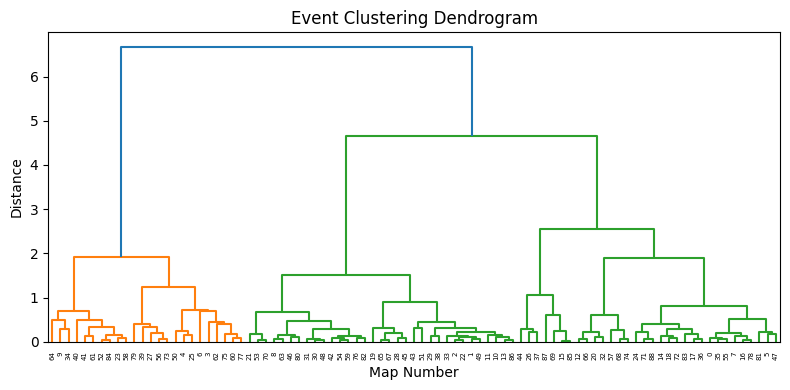

In [14]:
# -------------------------------
# Hierarchical clustering of first-event maps
# -------------------------------
# Perform clustering on the corrlation df
distance_matrix = 1 - first_event_corr
condensed_dist = squareform(distance_matrix.values)
linkage = sch.linkage(condensed_dist, method='ward')

# Plot dendrogram
plt.figure(figsize=(8, 4))
sch.dendrogram(linkage, labels=first_event_corr.columns.astype(str))
plt.title("Event Clustering Dendrogram")
plt.xlabel("Map Number")
plt.ylabel("Distance")
plt.tight_layout()
plt.show()

In [ ]:
# -------------------------------
# Assign cluster labels to first-event maps
# -------------------------------
n_clusters = 3 
cluster_labels = fcluster(linkage, n_clusters, criterion='maxclust')

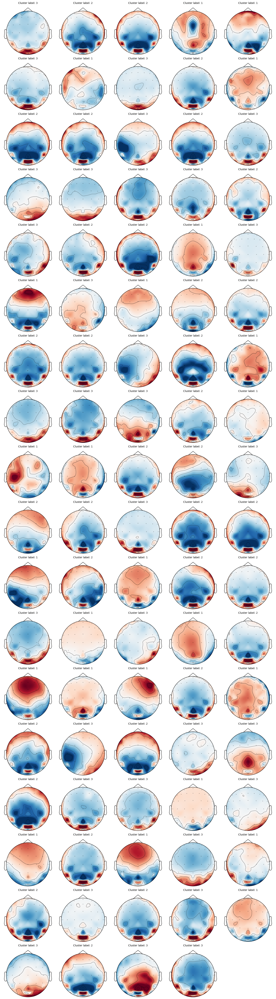

In [ ]:
# -------------------------------
# Visualize first-event maps with cluster labels
# -------------------------------
# Extract channel positions
epoch_data = models_third_session["subject_02"]["epoch_data"]
channel_names = epoch_data.channels.values.tolist()
montage = mne.channels.make_standard_montage('biosemi64')
positions = np.array([montage.get_positions()['ch_pos'][ch][:2] for ch in channel_names])

# Plotting
n_maps = len(first_event_df)
n_cols = 5
n_rows = (n_maps + n_cols - 1) // n_cols

# Create figure and axes
fig, axes = plt.subplots(n_rows, n_cols, figsize=(3 * n_cols, 3 * n_rows))
axes = axes.flatten()

# Plot each topomap
for idx, (_, row) in enumerate(first_event_df.iterrows()):
    cluster_label = cluster_labels[idx]
    mne.viz.plot_topomap(row.values, positions, axes=axes[idx], show=False)
    axes[idx].set_title(f"Cluster label: {cluster_label}", fontsize=10)

for ax in axes[n_maps:]:
    ax.set_visible(False)

plt.tight_layout()
plt.show()

In [ ]:
# -------------------------------
# Count maps per cluster
# -------------------------------
# Cluster 1
count_1 = (cluster_labels == 1).sum()
print(f"Cluster 1: {count_1} maps – shows the greatest variability, but in general, a frontal positivity.")
# Cluster 2
count_2 = (cluster_labels == 2).sum()
print(f"Cluster 2: {count_2} maps – shows a bilateral parietal negativity.")
# Cluster 3
count_3 = (cluster_labels == 3).sum()
print(f"Cluster 3: {count_3} maps – shows an occipital positivity.")

Cluster 1: 24 maps – shows the greatest variability, but in general, a frontal positivity.
Cluster 2: 33 maps – shows a bilateral parietal negativity.
Cluster 3: 32 maps – shows an occipital positivity.


In [ ]:
# -------------------------------
# Create dataframe for each cluster
# ------------------------------
# Cluster 1
cluster_1_indices = np.where(cluster_labels == 1)[0]
first_event_cluster_1 = first_event_df.iloc[cluster_1_indices]
# Cluster 2
cluster_2_indices = np.where(cluster_labels == 2)[0]
first_event_cluster_2 = first_event_df.iloc[cluster_2_indices]
# Cluster 3
cluster_3_indices = np.where(cluster_labels == 3)[0]
first_event_cluster_3 = first_event_df.iloc[cluster_3_indices]

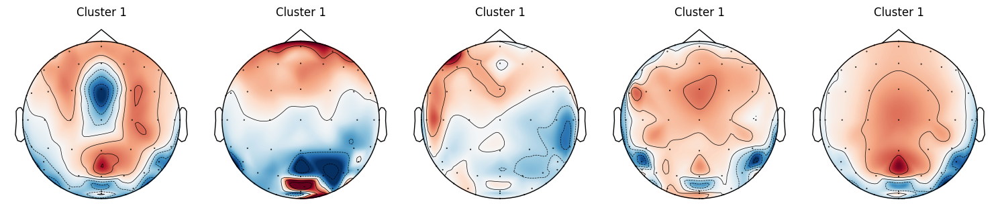

In [ ]:
# -------------------------------
# Plot first five observations of cluster 1
# ------------------------------
df_subset = first_event_cluster_1[0:5]
n_events = 5
fig, axes = plt.subplots(1, n_events, figsize=(3 * n_events, 3))

for idx, (_, row) in enumerate(df_subset.iterrows()):
    avg_map = row.values 
    mne.viz.plot_topomap(avg_map, positions, axes=axes[idx], show=False)
    axes[idx].set_title("Cluster 1")

plt.tight_layout()
plt.show()

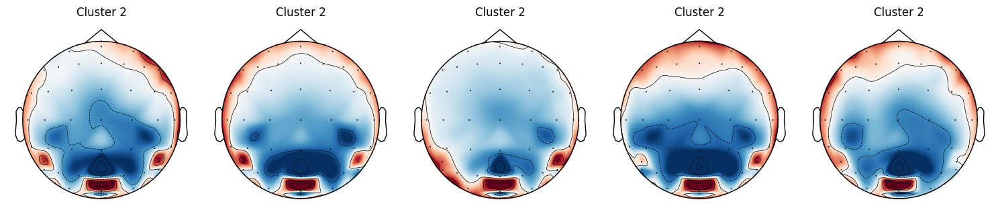

In [ ]:
# -------------------------------
# Plot first five observations of cluster 2
# ------------------------------
df_subset = first_event_cluster_2[0:5]
n_events = 5
fig, axes = plt.subplots(1, n_events, figsize=(3 * n_events, 3))

for idx, (_, row) in enumerate(df_subset.iterrows()):
    avg_map = row.values 
    mne.viz.plot_topomap(avg_map, positions, axes=axes[idx], show=False)
    axes[idx].set_title("Cluster 2")

plt.tight_layout()
plt.show()

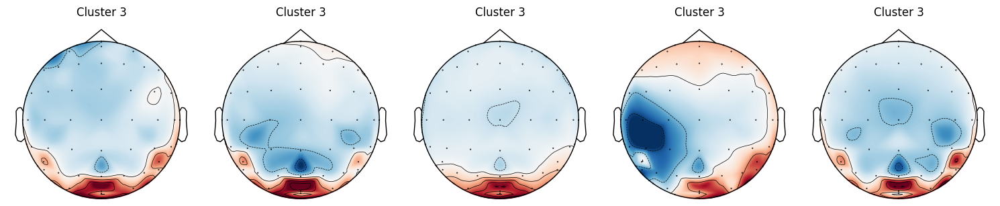

In [ ]:
# -------------------------------
# Plot first five observations of cluster 3
# ------------------------------
df_subset = first_event_cluster_3[0:5]
n_events = 5
fig, axes = plt.subplots(1, n_events, figsize=(3 * n_events, 3))

for idx, (_, row) in enumerate(df_subset.iterrows()):
    avg_map = row.values 
    mne.viz.plot_topomap(avg_map, positions, axes=axes[idx], show=False)
    axes[idx].set_title("Cluster 3")

plt.tight_layout()
plt.show()

Mean spatial correlation: 0.17440658465884828


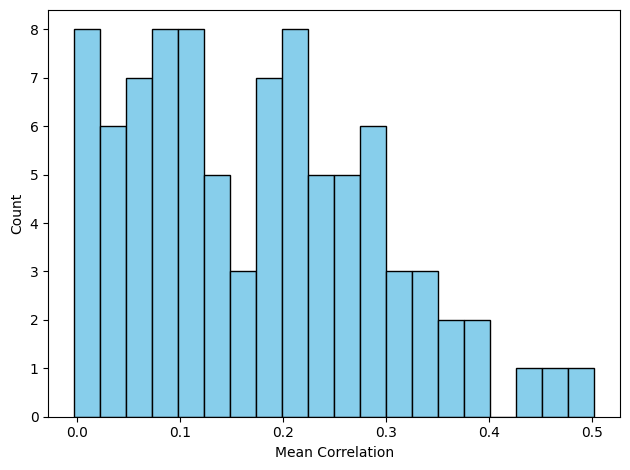

In [ ]:
# -------------------------------
# Mean correlation of first event
# ------------------------------
first_event_corr = []

# Aggregate all models across sessions
for subject, model_info in chain(models_first_session.items(),
                                 models_second_session.items(),
                                 models_third_session.items(),
                                 models_fourth_session.items(),
                                 models_fifth_session.items()):
    
    model = model_info["model"]
    epoch_data = model_info["epoch_data"]
    eventprobs = model.eventprobs.values
    abs_timing_list = event_abs_timing_list(eventprobs, 0)

    matrix_of_values = []  
    
    for idx, sample_idx in enumerate(abs_timing_list):
        values = epoch_data.isel(epochs=idx, samples=sample_idx).data.values[0]
        matrix_of_values.append(values)

    matrix_df = pd.DataFrame(matrix_of_values)
    similarity_matrix = matrix_df.T.corr()
    upper_triangle = similarity_matrix.where(np.triu(np.ones(similarity_matrix.shape), k=1).astype(bool))
    mean_corr = upper_triangle.stack().mean()
    first_event_corr.append(mean_corr)

# Compute mean correlation for the firts event across subjects and sessions
mean_corr = np.mean(first_event_corr)
print(f"Mean spatial correlation: {mean_corr}")

plt.hist(first_event_corr, bins=20, color='skyblue', edgecolor='black')
plt.xlabel("Mean Correlation")
plt.ylabel("Count")
plt.tight_layout()
plt.show()

The mean latency of the first event was 68.93 ms
61 events with mean latency over 40 ms


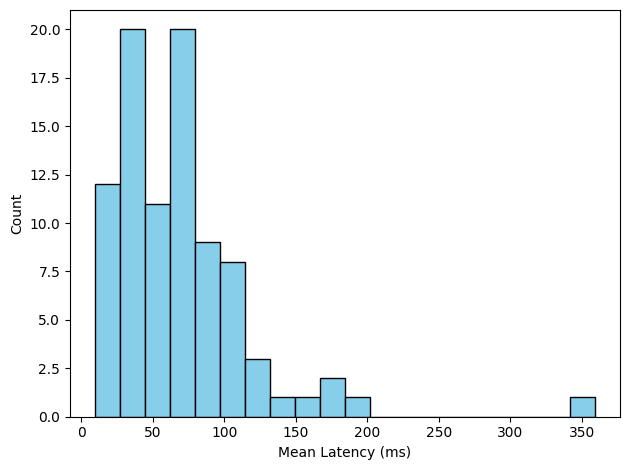

In [ ]:
# -------------------------------
# Mean latency of first event
# ------------------------------
first_event_mean_latency = []

# Aggregate all models across sessions
for subject, model_info in chain(models_first_session.items(),
                                 models_second_session.items(),
                                 models_third_session.items(),
                                 models_fourth_session.items(),
                                 models_fifth_session.items()):
    
    model = model_info["model"]
    epoch_data = model_info["epoch_data"]
    eventprobs = model.eventprobs.values
    abs_timing_list = event_abs_timing_list(eventprobs, 0)
    mean_latency_ms = np.mean(abs_timing_list) * 2 # Convert to ms (2 ms per sample at 500 Hz)
    first_event_mean_latency.append(mean_latency_ms)
    
overall_mean_latency_ms = np.mean(first_event_mean_latency)
print(f"The mean latency of the first event was {overall_mean_latency_ms:.2f} ms")
count_over_40 = sum(x > 40 for x in first_event_mean_latency)
print(f"{count_over_40} events with mean latency over 40 ms")

# Plot histogram in ms
plt.hist(first_event_mean_latency, bins=20, color='skyblue', edgecolor='black')
plt.xlabel("Mean Latency (ms)")
plt.ylabel("Count")
plt.tight_layout()
plt.show()

C:\Users\celia\AppData\Local\Programs\Python\Python313\Lib\site-packages\seaborn\categorical.py:700: PendingDeprecationWarning: vert: bool will be deprecated in a future version. Use orientation: {'vertical', 'horizontal'} instead.
  artists = ax.bxp(**boxplot_kws)


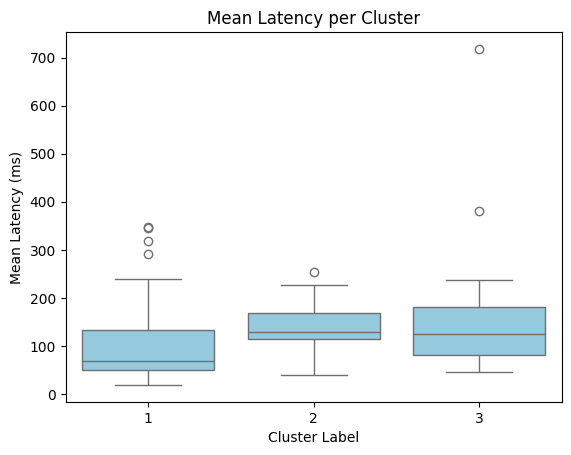

In [ ]:
# -------------------------------
# Boxplot of latency of first event per cluster
# -------------------------------
df = pd.DataFrame({"cluster_label": cluster_labels,"mean_latency": first_event_mean_latency})
df["mean_latency"] = round(df.mean_latency*2)

sns.boxplot(x="cluster_label", y="mean_latency", data=df, color='skyblue')
plt.title("Mean Latency per Cluster")
plt.xlabel("Cluster Label")
plt.ylabel("Mean Latency (ms)")
plt.show()

In [ ]:
# -------------------------------
# Silhouette score for clustering solution
# -------------------------------
score = silhouette_score(first_event_df, cluster_labels, metric='euclidean')
print(f"Silhouette score for all clusters: {score:.3f}")

# What is the silhouette score for only cluster 2 and 3?
indices = np.where((cluster_labels == 2) | (cluster_labels == 3))[0]
first_event_df_subset = first_event_df.iloc[indices]
filtered_labels = cluster_labels[(cluster_labels == 2) | (cluster_labels == 3)]
score = silhouette_score(first_event_df_subset, filtered_labels, metric='euclidean')
print(f"Silhouette score for two-cluster solution: {score:.3f}")

Silhouette score for all clusters: 0.183
Silhouette score for two-cluster solution: 0.207


In [ ]:
# -------------------------------
# Within-cluster and overall map correlations
# -------------------------------
# CLuster 1
indices = np.where((cluster_labels == 1))[0] 
first_event_cluster_1 = first_event_df.iloc[indices]
similarity_matrix = first_event_cluster_1.T.corr()
upper_triangle = similarity_matrix.where(np.triu(np.ones(similarity_matrix.shape), k=1).astype(bool))
mean_corr = upper_triangle.stack().mean()
print(f"Mean correlation for cluster 1 maps is {mean_corr}")

# Cluster 2
indices = np.where((cluster_labels == 2))[0]
first_event_cluster_2 = first_event_df.iloc[indices]
similarity_matrix = first_event_cluster_2.T.corr()
upper_triangle = similarity_matrix.where(np.triu(np.ones(similarity_matrix.shape), k=1).astype(bool))
mean_corr = upper_triangle.stack().mean()
print(f"Mean correlation for cluster 2 maps is {mean_corr}")

# CLuster 3
indices = np.where((cluster_labels == 3))[0]
first_event_cluster_3 = first_event_df.iloc[indices]
similarity_matrix = first_event_cluster_3.T.corr()
upper_triangle = similarity_matrix.where(np.triu(np.ones(similarity_matrix.shape), k=1).astype(bool))
mean_corr = upper_triangle.stack().mean()
print(f"Mean correlation for cluster 3 maps is {mean_corr}")

# All maps
similarity_matrix = first_event_df.T.corr()
upper_triangle = similarity_matrix.where(np.triu(np.ones(similarity_matrix.shape), k=1).astype(bool))
mean_corr = upper_triangle.stack().mean()
print(f"Mean correlation for all maps is {mean_corr}")

Mean correlation for cluster 1 maps is 0.47041986284172466
Mean correlation for cluster 2 maps is 0.6772510008127257
Mean correlation for cluster 3 maps is 0.4367530077215141
Mean correlation for all maps is 0.11234535982780426


# Mid-trial Events

In [ ]:
# -------------------------------
# Extract middle events across sessions and subjects
# -------------------------------
fs = 500  # Hz
middle_event_lists = []        # kept avg maps 
subject_n_for_event = []       # subject id per kept map
latency_ms_for_event = []      # mean latency (ms) per kept map
rel_latency_event = []         # mean relative latency 

# Aggregate all models across sessions
for subject, model_info in chain(models_first_session.items(),
                                 models_second_session.items(),
                                 models_third_session.items(),
                                 models_fourth_session.items(),
                                 models_fifth_session.items()):
    print(f"Processing subject: {subject}")

    model = model_info["model"]
    epoch_data = model_info["epoch_data"]

    # RTs
    rt_per_trial_s = np.asarray(epoch_data.rt.values)        # seconds, per trial
    rt_ms = float(np.mean(rt_per_trial_s) * 1000.0)          # mean RT in ms (to determine the interval defined as middle)

    eventprobs = model.eventprobs.values
    n_events = eventprobs.shape[2]

    avg_latency_list = []       # mean absolute latency (ms) per event (across trials)
    avg_rel_latency_list = []   # mean relative latency per event (across trials)
    avg_event_lists = []        # average maps per event

    # Compute mean latency (ms), mean relative latency, and avg map per event
    for event in range(n_events):
        abs_timing_list = event_abs_timing_list(eventprobs, event)  # in samples, per trial 
        rel_timing_list = event_rel_timing_list(eventprobs, rt_per_trial_s, event)  # unitless per trial

        avg_map = average_map_for_event(abs_timing_list, epoch_data)

        mean_latency_ms = float(np.mean(abs_timing_list)) * (1000.0 / fs)
        mean_rel_latency = float(np.mean(rel_timing_list))

        avg_latency_list.append(mean_latency_ms)
        avg_rel_latency_list.append(mean_rel_latency)
        avg_event_lists.append(avg_map)

    avg_event_df = pd.DataFrame(avg_event_lists)       # rows = events, cols = channels
    avg_latency_array = np.asarray(avg_latency_list)   # ms
    avg_rel_latency_array = np.asarray(avg_rel_latency_list)  # unitless

    # Select events in middle interval (absolute ms window)
    interval_mask = (avg_latency_array >= 300.0) & (avg_latency_array <= (rt_ms - 500.0))
    events_to_keep = np.where(interval_mask)[0]

    if events_to_keep.size == 0:
        print(f"  No events kept for subject {subject} (interval filter removed all).")
        continue

    # Subset maps and latencies for the kept events
    avg_event_subset_df = avg_event_df.iloc[events_to_keep, :].reset_index(drop=True)
    latency_subset = avg_latency_array[events_to_keep]
    rel_latency_subset = avg_rel_latency_array[events_to_keep]

    # Cluster-aware selection (compare to cluster start; keep only starts)
    corr_diff_threshold = 0.3
    n_subset_events = len(avg_event_subset_df)

    # Initialize cluster with the first kept event
    cluster_start_map = avg_event_subset_df.iloc[0].values
    cluster_start_latency = latency_subset[0]
    cluster_start_rel_latency = rel_latency_subset[0]

    kept_maps = [cluster_start_map]
    kept_latencies = [cluster_start_latency]
    kept_rel_latencies = [cluster_start_rel_latency]

    # Compare each subsequent event to the cluster start
    for j in range(1, n_subset_events):
        this_map = avg_event_subset_df.iloc[j].values
        r = np.corrcoef(cluster_start_map, this_map)[0, 1]
        corr_drop = 1.0 - r

        if corr_drop > corr_diff_threshold:
            # New cluster → update all "cluster_start" variables
            cluster_start_map = this_map
            cluster_start_latency = latency_subset[j]
            cluster_start_rel_latency = rel_latency_subset[j]

            kept_maps.append(cluster_start_map)
            kept_latencies.append(cluster_start_latency)
            kept_rel_latencies.append(cluster_start_rel_latency)

    # Accumulate across subjects
    middle_event_lists.extend(kept_maps)
    subject_n_for_event.extend([subject] * len(kept_maps))
    latency_ms_for_event.extend(kept_latencies)
    rel_latency_event.extend(kept_rel_latencies)

    print(f"  Kept {len(kept_maps)} distinct events for subject {subject}")

Processing subject: subject_01
  Kept 1 distinct events for subject subject_01
Processing subject: subject_02
  Kept 1 distinct events for subject subject_02
Processing subject: subject_03
  Kept 1 distinct events for subject subject_03
Processing subject: subject_04
  Kept 2 distinct events for subject subject_04
Processing subject: subject_05
  Kept 1 distinct events for subject subject_05
Processing subject: subject_06
  Kept 3 distinct events for subject subject_06
Processing subject: subject_08
  Kept 2 distinct events for subject subject_08
Processing subject: subject_09
  Kept 1 distinct events for subject subject_09
Processing subject: subject_10
  Kept 2 distinct events for subject subject_10
Processing subject: subject_11
  Kept 1 distinct events for subject subject_11
Processing subject: subject_12
  Kept 4 distinct events for subject subject_12
Processing subject: subject_14
  Kept 3 distinct events for subject subject_14
Processing subject: subject_15
  Kept 2 distinct eve

In [ ]:
# Convert to dataframe
middle_event_df = pd.DataFrame(middle_event_lists)

In [ ]:
# Compute correlation matrix of middle-trial event maps
middle_event_corr = middle_event_df.T.corr()

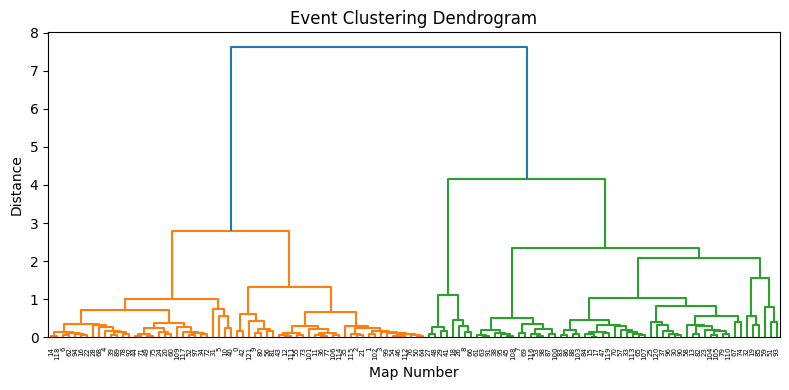

In [ ]:
# -------------------------------
# Hierarchical clustering of middle-event maps
# -------------------------------
distance_matrix = 1 - middle_event_corr
condensed_dist = squareform(distance_matrix.values)
linkage = sch.linkage(condensed_dist, method='ward')

# Plot dendrogram
plt.figure(figsize=(8, 4))
sch.dendrogram(linkage, labels=middle_event_corr.columns.astype(str))
plt.title("Event Clustering Dendrogram")
plt.xlabel("Map Number")
plt.ylabel("Distance")
plt.tight_layout()
plt.show()

In [ ]:
# -------------------------------
# Assign cluster labels to middle-event maps
# -------------------------------
n_clusters = 2  
cluster_labels = fcluster(linkage, n_clusters, criterion='maxclust')

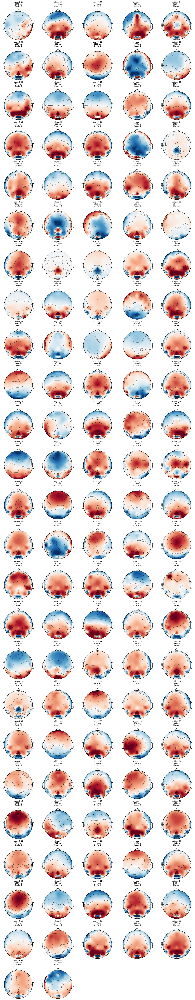

In [ ]:
# -------------------------------
# Visualize first-event maps with cluster labels
# -------------------------------
n_maps = len(middle_event_df)
n_cols = 5
n_rows = (n_maps + n_cols - 1) // n_cols

fig, axes = plt.subplots(n_rows, n_cols, figsize=(3 * n_cols, 3 * n_rows))
axes = axes.flatten()

for idx, (_, row) in enumerate(middle_event_df.iterrows()):
    mne.viz.plot_topomap(row.values, positions, axes=axes[idx], show=False)
    subj = subject_n_for_event[idx]
    lat  = latency_ms_for_event[idx]    # ms
    clus = cluster_labels[idx]          # cluster label
    axes[idx].set_title(f"{subj}\n{lat:.0f} ms\nCluster {clus}", fontsize=9)

# Hide unused subplots
for ax in axes[n_maps:]:
    ax.set_visible(False)

plt.tight_layout()
plt.show()

In [ ]:
# -------------------------------
# Count maps per cluster
# -------------------------------
# Cluster 1
count_1 = (cluster_labels == 1).sum()
print(f"Cluster 1: {count_1} maps – shows a focal bilateral positivity, often extending centrally")
# Cluster 2
count_2 = (cluster_labels == 2).sum()
print(f"Cluster 2: {count_2} maps – shows a frontal positivity or very broad central positivity")

Cluster 1: 63 maps – shows a focal bilateral positivity, often extending centrally
Cluster 2: 59 maps – shows a frontal positivity or very broad central positivity


In [ ]:
# -------------------------------
# Create dataframe for each cluster
# ------------------------------
# Cluster 1
cluster_1_indices = np.where(cluster_labels == 1)[0]
middle_event_cluster_1 = middle_event_df.iloc[cluster_1_indices]
# Cluster 2
cluster_2_indices = np.where(cluster_labels == 2)[0]
middle_event_cluster_2 = middle_event_df.iloc[cluster_2_indices]

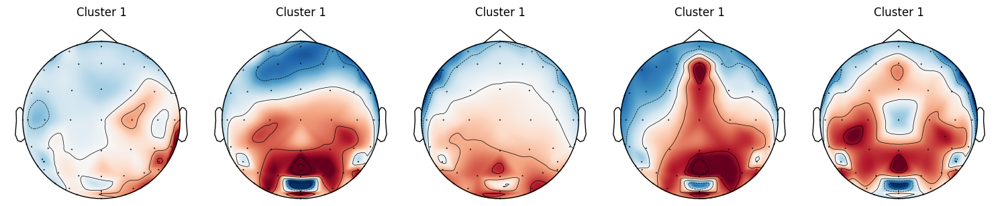

In [ ]:
# -------------------------------
# Plot first five observations of cluster 1
# ------------------------------
df_subset = middle_event_cluster_1[0:5]
n_events = 5
fig, axes = plt.subplots(1, n_events, figsize=(3 * n_events, 3))

for idx, (_, row) in enumerate(df_subset.iterrows()):
    avg_map = row.values 
    mne.viz.plot_topomap(avg_map, positions, axes=axes[idx], show=False)
    axes[idx].set_title("Cluster 1")

plt.tight_layout()
plt.show()

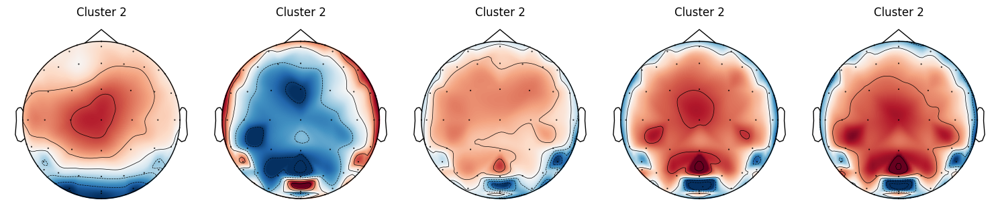

In [ ]:
# -------------------------------
# Plot first five observations of cluster 2
# ------------------------------
df_subset = middle_event_cluster_2[0:5]
n_events = 5
fig, axes = plt.subplots(1, n_events, figsize=(3 * n_events, 3))

for idx, (_, row) in enumerate(df_subset.iterrows()):
    avg_map = row.values 
    mne.viz.plot_topomap(avg_map, positions, axes=axes[idx], show=False)
    axes[idx].set_title("Cluster 2")

plt.tight_layout()
plt.show()

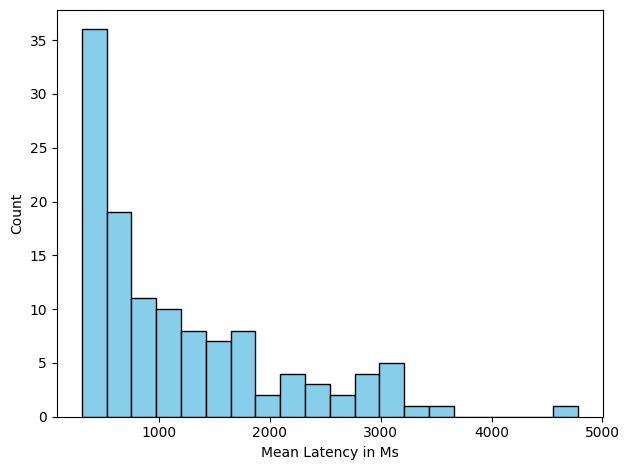

In [ ]:
# -------------------------------
# Mean latency of middle events
# ------------------------------
plt.hist(latency_ms_for_event, bins=20, color='skyblue', edgecolor='black')
plt.xlabel("Mean Latency in Ms")
plt.ylabel("Count")
plt.tight_layout()
plt.show()

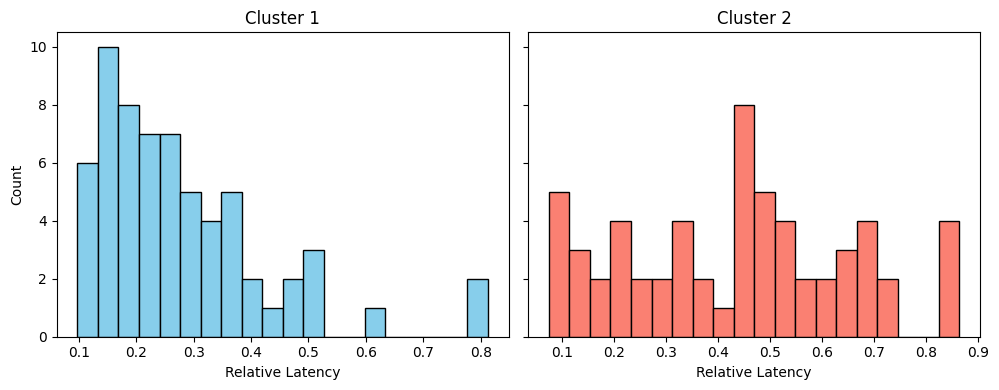

In [ ]:
# -------------------------------
# Mean relative latency of middle events
# ------------------------------
# Convert to numpy array for indexing
rel_latency_event = np.array(rel_latency_event)

# Get indices per cluster
cluster_1_indices = np.where(cluster_labels == 1)[0]
cluster_2_indices = np.where(cluster_labels == 2)[0]

# Subset relative timing
rel_timing_cluster_1 = rel_latency_event[cluster_1_indices]
rel_timing_cluster_2 = rel_latency_event[cluster_2_indices]

# Create side-by-side plots
fig, axes = plt.subplots(1, 2, figsize=(10, 4), sharey=True)

# Cluster 1
axes[0].hist(rel_timing_cluster_1, bins=20, color='skyblue', edgecolor='black')
axes[0].set_title("Cluster 1", fontsize=12)
axes[0].set_xlabel("Relative Latency")
axes[0].set_ylabel("Count")

# Cluster 2
axes[1].hist(rel_timing_cluster_2, bins=20, color='salmon', edgecolor='black')
axes[1].set_title("Cluster 2", fontsize=12)
axes[1].set_xlabel("Relative Latency")

plt.tight_layout()
plt.show()

In [ ]:
# -------------------------------
# Silhouette score for clustering solution
# ------------------------------
score = silhouette_score(middle_event_df, cluster_labels, metric='euclidean')
print(f"Silhouette score for all clusters: {score:.3f}")

Silhouette score for all clusters: 0.273


In [ ]:
# -------------------------------
# Within-cluster and overall map correlations
# -------------------------------
# CLuster 1
similarity_matrix = middle_event_cluster_1.T.corr()
upper_triangle = similarity_matrix.where(np.triu(np.ones(similarity_matrix.shape), k=1).astype(bool))
mean_corr = upper_triangle.stack().mean()
print(f"Mean correlation for cluster 1 maps is {mean_corr}")

# Cluster 2
similarity_matrix = middle_event_cluster_2.T.corr()
upper_triangle = similarity_matrix.where(np.triu(np.ones(similarity_matrix.shape), k=1).astype(bool))
mean_corr = upper_triangle.stack().mean()
print(f"Mean correlation for cluster 2 maps is {mean_corr}")

# All maps
similarity_matrix = middle_event_df.T.corr()
upper_triangle = similarity_matrix.where(np.triu(np.ones(similarity_matrix.shape), k=1).astype(bool))
mean_corr = upper_triangle.stack().mean()
print(f"Mean correlation for all maps is {mean_corr}")

Mean correlation for cluster 1 maps is 0.6064507081313883
Mean correlation for cluster 2 maps is 0.3453371083993023
Mean correlation for all maps is 0.20491663587834086


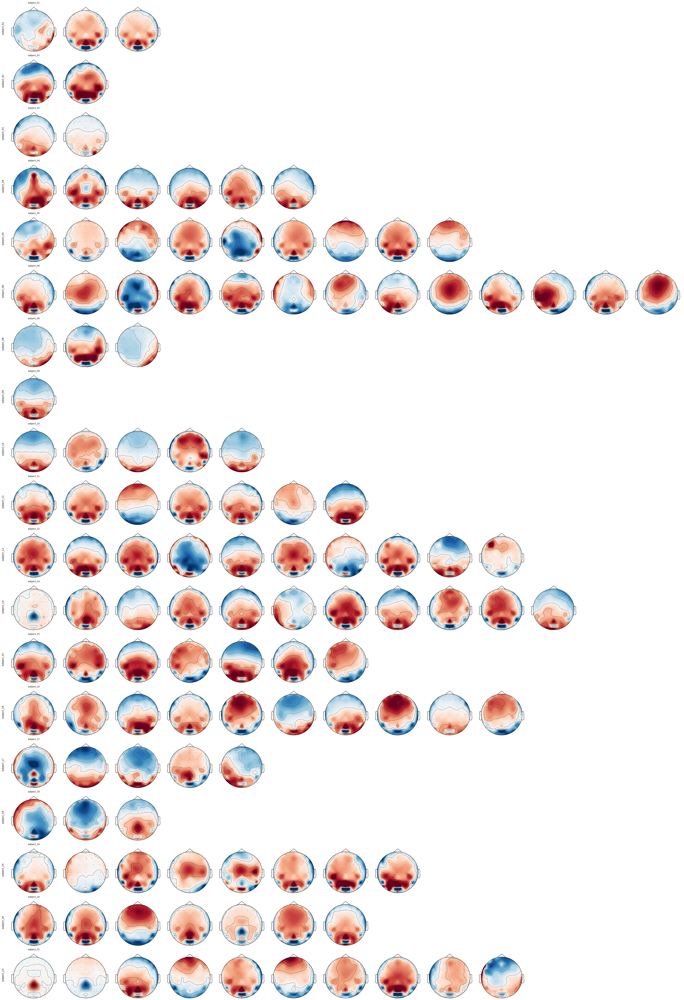

In [ ]:
# -------------------------------
# Maps of mid-trial events, organized by subject
# -------------------------------
subject_n_for_event = np.asarray(subject_n_for_event)
subjects = list(dict.fromkeys(subject_n_for_event.tolist()))
idxs_by_subj = {s: np.where(subject_n_for_event == s)[0] for s in subjects}

n_rows = len(subjects)
n_cols = max(len(idxs) for idxs in idxs_by_subj.values())
n_cols = max(n_cols, 1)

fig, axes = plt.subplots(n_rows, n_cols, figsize=(3*n_cols, 3*n_rows), squeeze=False)

for row, subj in enumerate(subjects):
    idxs = idxs_by_subj[subj]
    maps_for_subj = middle_event_df.iloc[idxs, :].reset_index(drop=True)

    for column in range(n_cols):
        ax = axes[row, column]
        if column < len(maps_for_subj):
            vals = maps_for_subj.iloc[column].values
            mne.viz.plot_topomap(vals, positions, axes=ax, show=False)
            ax.set_title(f"{subj}", fontsize=9) if column == 0 else ax.set_title("")
        else:
            ax.set_visible(False)

    axes[row, 0].set_ylabel(subj, rotation=90, fontsize=10, labelpad=20)

plt.tight_layout()
plt.show()

In [ ]:
# -------------------------------
# Mean within-subject correlation of mid-trial maps
# -------------------------------
subject_n_for_event = np.asarray(subject_n_for_event)
subjects = list(dict.fromkeys(subject_n_for_event.tolist()))

mean_corr_per_subject = {}

for subj in subjects:
    idxs = np.where(subject_n_for_event == subj)[0]
    maps_for_subj = middle_event_df.iloc[idxs, :].values  # (n_maps, n_channels)

    if maps_for_subj.shape[0] > 1:
        corr_matrix = np.corrcoef(maps_for_subj)
        upper_triangle = corr_matrix[np.triu_indices_from(corr_matrix, k=1)]
        mean_corr = np.mean(upper_triangle)
        mean_corr_per_subject[subj] = mean_corr
    else:
        mean_corr_per_subject[subj] = np.nan

for subj, mean_corr in mean_corr_per_subject.items():
    print(f"{subj}: {mean_corr:.3f}")

subject_01: 0.220
subject_02: 0.736
subject_03: 0.726
subject_04: 0.775
subject_05: 0.340
subject_06: 0.193
subject_08: 0.387
subject_09: nan
subject_10: 0.212
subject_11: 0.231
subject_12: 0.178
subject_14: 0.385
subject_15: 0.364
subject_16: 0.251
subject_17: 0.126
subject_18: -0.233
subject_19: 0.333
subject_20: 0.486
subject_22: 0.140


In [ ]:
# -------------------------------
# Mean within-subject spatial consistency of events
# -------------------------------
mean_corr_values = np.array(list(mean_corr_per_subject.values()))
mean_corr_overall = np.nanmean(mean_corr_values)

print(f"Mean correlation averaged over subjects: {mean_corr_overall:.3f}")

Mean correlation averaged over subjects: 0.325


In [ ]:
# -------------------------------
# Within-cluster mean correlations per subject 
# -------------------------------

# Convert to array for boolean masking
subject_arr = np.asarray(subject_n_for_event)
cluster_arr = np.asarray(cluster_labels)

# Preserve subject order as they appeared
subjects = list(dict.fromkeys(subject_arr.tolist()))
clusters = np.unique(cluster_arr)

rows = []
for subj in subjects:
    for clus in clusters:
        mask = (subject_arr == subj) & (cluster_arr == clus)
        idxs = np.where(mask)[0]
        n_maps = len(idxs)

        if n_maps > 1:
            maps = middle_event_df.iloc[idxs, :].values  # (n_maps, n_channels)
            C = np.corrcoef(maps)
            triu_vals = C[np.triu_indices_from(C, k=1)]
            mean_corr = float(np.mean(triu_vals))
        else:
            mean_corr = np.nan

        rows.append({"subject": subj, "cluster": int(clus), "n_maps": n_maps, "mean_corr": mean_corr})


within_cluster_df = pd.DataFrame(rows)

# Overall (mean of per-subject means) for each cluster
overall_by_cluster = (
    within_cluster_df
    .groupby("cluster")["mean_corr"]
    .mean()  # skipna=True by default
    .rename("mean_corr_over_subjects")
    .reset_index()
)

print("\nMean of per-subject means, by cluster:")
print(overall_by_cluster)

pivot_table = within_cluster_df.pivot(index="subject", columns="cluster", values="mean_corr")
print("\nPivot (subjects x clusters):")
print(pivot_table)



Mean of per-subject means, by cluster:
   cluster  mean_corr_over_subjects
0        1                 0.695714
1        2                 0.441912

Pivot (subjects x clusters):
cluster            1         2
subject                       
subject_01       NaN  0.878341
subject_02  0.736122       NaN
subject_03  0.725923       NaN
subject_04  0.775161       NaN
subject_05       NaN  0.447648
subject_06  0.703136  0.292809
subject_08  0.387428       NaN
subject_09       NaN       NaN
subject_10  0.951541  0.632222
subject_11  0.745283  0.935196
subject_12  0.771232  0.132037
subject_14  0.718331  0.043921
subject_15  0.836606  0.879885
subject_16  0.717674  0.719742
subject_17  0.784544 -0.525798
subject_18  0.358711       NaN
subject_19  0.790201  0.308716
subject_20  0.889773  0.565052
subject_22  0.239757  0.435082
